# Python Geospatial Tools Webinar

## Foundational tools

The geospatial ecosystem in Python builds on a number of foundational tools much like the rest of the Python scientific ecosystem.

### Numpy

NumPy is the fundamental package for scientific computing in Python. It is a Python library that provides a multidimensional array object, various derived objects (such as masked arrays and matrices), and an assortment of routines for fast operations on arrays, including mathematical, logical, shape manipulation, sorting, selecting, I/O, discrete Fourier transforms, basic linear algebra, basic statistical operations, random simulation and much more.

- [Documentation](https://numpy.org/doc/stable/index.html)
- [GitHub](https://github.com/numpy/numpy)

Installation:

```
conda install numpy
```

In [1]:
import numpy as np

a = np.array([1, 2, 3])

a

array([1, 2, 3])

### Pandas

pandas is an open source, BSD-licensed library providing high-performance, easy-to-use data structures and data analysis tools for the Python programming language.

- [Documentation](https://pandas.pydata.org/docs/)
- [GitHub](https://github.com/pandas-dev/pandas)

Installation:

```
conda install pandas
```

In [2]:
import pandas as pd

df = pd.DataFrame(
    {
        "Name": [
            "Braund, Mr. Owen Harris",
            "Allen, Mr. William Henry",
            "Bonnell, Miss. Elizabeth",
        ],
        "Age": [22, 35, 58],
        "Sex": ["male", "male", "female"],
    }
)

df

,Name,Age,Sex
0,"Braund, Mr. Owen Harris",22,male
1,"Allen, Mr. William Henry",35,male
2,"Bonnell, Miss. Elizabeth",58,female


### Dask

Dask is a flexible library for parallel computing in Python.

- [Documentation](https://docs.dask.org/en/latest/)
- [GitHub](https://github.com/pandas-dev/pandas)

Installation:

```
conda install dask
```

#### dask.distributed

Starting the Dask Client is optional. It will provide a dashboard which is useful to gain insight on the computation.

In [2]:
from dask.distributed import Client, progress

client = Client(processes=False, threads_per_worker=4,
                n_workers=1, memory_limit='16GB')

client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://192.168.1.2:8787/status,
Dashboard: http://192.168.1.2:8787/status,Workers: 1
Total threads: 4,Total memory: 14.90 GiB
Status: running,Using processes: False
Comm: inproc://192.168.1.2/28342/1,Workers: 1
Dashboard: http://192.168.1.2:8787/status,Total threads: 4
Started: Just now,Total memory: 14.90 GiB
Comm: inproc://192.168.1.2/28342/3,Total threads: 4
Dashboard: http://192.168.1.2:55023/status,Memory: 14.90 GiB
Nanny: None,


#### dask.array

Dask arrays coordinate many Numpy arrays, arranged into chunks within a grid. They support a large subset of the Numpy API.

In [53]:
import dask.array as da

x = da.random.random((10000, 10000), chunks=(1000, 1000))

x

dask.array<random_sample, shape=(10000, 10000), dtype=float64, chunksize=(1000, 1000), chunktype=numpy.ndarray>

In [54]:
summed = x.sum(axis=0)

summed

dask.array<sum-aggregate, shape=(10000,), dtype=float64, chunksize=(1000,), chunktype=numpy.ndarray>

In [55]:
summed.compute()

array([4976.03578838, 5036.46829038, 5001.65992823, ..., 5017.88390667,
       4977.20086496, 4950.96232468])

#### dask.dataframe

Dask Dataframes coordinate many Pandas dataframes, partitioned along an index. They support a large subset of the Pandas API.

In [92]:
import dask

import dask.dataframe as dd

ddf = dask.datasets.timeseries()

ddf

,id,name,x,y
npartitions=30,,,,
2000-01-01,int64,object,float64,float64
2000-01-02,...,...,...,...
...,...,...,...,...
2000-01-30,...,...,...,...
2000-01-31,...,...,...,...


In [94]:
ddf2 = ddf[ddf.y > 0]

ddf3 = ddf2.groupby('name').x.std()

ddf3.compute()

name
Alice       0.577214
Bob         0.578138
Charlie     0.575391
Dan         0.577333
Edith       0.577921
Frank       0.576120
George      0.578217
Hannah      0.577426
Ingrid      0.577249
Jerry       0.576852
Kevin       0.577533
Laura       0.577085
Michael     0.578168
Norbert     0.575755
Oliver      0.576329
Patricia    0.576829
Quinn       0.577643
Ray         0.578568
Sarah       0.576918
Tim         0.576271
Ursula      0.576577
Victor      0.576908
Wendy       0.578110
Xavier      0.578137
Yvonne      0.576245
Zelda       0.578061
Name: x, dtype: float64

### Numba

Numba translates Python functions to optimized machine code at runtime using the industry-standard LLVM compiler library. Numba-compiled numerical algorithms in Python can approach the speeds of C or FORTRAN.

- [Documentation](https://numba.pydata.org/)
- [GitHub](https://github.com/numba/numba)

Installation:

```
conda install numba
```

In [59]:
from numba import jit

x = np.arange(100).reshape(10, 10)

@jit(nopython=True) # Set "nopython" mode for best performance, equivalent to @njit
def go_fast(a): # Function is compiled to machine code when called the first time
    trace = 0.0
    for i in range(a.shape[0]):   # Numba likes loops
        trace += np.tanh(a[i, i]) # Numba likes NumPy functions
    return a + trace              # Numba likes NumPy broadcasting

print(go_fast(x))

[[  9.  10.  11.  12.  13.  14.  15.  16.  17.  18.]
 [ 19.  20.  21.  22.  23.  24.  25.  26.  27.  28.]
 [ 29.  30.  31.  32.  33.  34.  35.  36.  37.  38.]
 [ 39.  40.  41.  42.  43.  44.  45.  46.  47.  48.]
 [ 49.  50.  51.  52.  53.  54.  55.  56.  57.  58.]
 [ 59.  60.  61.  62.  63.  64.  65.  66.  67.  68.]
 [ 69.  70.  71.  72.  73.  74.  75.  76.  77.  78.]
 [ 79.  80.  81.  82.  83.  84.  85.  86.  87.  88.]
 [ 89.  90.  91.  92.  93.  94.  95.  96.  97.  98.]
 [ 99. 100. 101. 102. 103. 104. 105. 106. 107. 108.]]


### Cupy

CuPy is an implementation of NumPy-compatible multi-dimensional array on CUDA. CuPy consists of cupy.ndarray, the core multi-dimensional array class, and many functions on it. It supports a subset of numpy.ndarray interface.

- [Documentation](https://docs.cupy.dev/en/stable/)
- [GitHub](https://github.com/cupy/cupy)

Installation:

```
conda install -c conda-forge cupy
```

In [ ]:
import cupy as cp

x = cp.arange(6).reshape(2, 3).astype('f')

x

In [ ]:
x.sum(axis=1)

## Vector Data

<img src="vector_data2.png"></img>

### Geopandas

GeoPandas is an open source project to make working with geospatial data in python easier. GeoPandas extends the datatypes used by pandas to allow spatial operations on geometric types. Geometric operations are performed by shapely. Geopandas further depends on fiona for file access and matplotlib for plotting.

- [Documentation](https://geopandas.org/docs.html)
- [GitHub](https://github.com/geopandas/geopandas)

Installation:

```
conda install -c conda-forge geopandas
```

In [95]:
import geopandas as gpd

url = "http://d2ad6b4ur7yvpq.cloudfront.net/naturalearth-3.3.0/ne_110m_land.geojson"
gdf = gpd.read_file(url)

gdf

,scalerank,featureclass,geometry
0,1,Country,"POLYGON ((-59.57209 -80.04018, -59.86585 -80.5..."
1,1,Country,"POLYGON ((-159.20818 -79.49706, -161.12760 -79..."
2,1,Country,"POLYGON ((-45.15476 -78.04707, -43.92083 -78.4..."
3,1,Country,"POLYGON ((-121.21151 -73.50099, -119.91885 -73..."
4,1,Country,"POLYGON ((-125.55957 -73.48135, -124.03188 -73..."
...,...,...,...
122,1,Country,"POLYGON ((51.13619 80.54728, 49.79368 80.41543..."
123,1,Country,"POLYGON ((99.93976 78.88094, 97.75794 78.75620..."
124,1,Country,"POLYGON ((-87.02000 79.66000, -85.81435 79.336..."
125,1,Country,"POLYGON ((-68.50000 83.10632, -65.82735 83.028..."


Indexing the geometry column returns `shapely` objects:

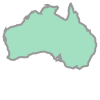

In [96]:
gdf.geometry.iloc[21]

However underlying this is a `GeometryArray` class:

In [97]:
type(gdf.geometry.values)

geopandas.array.GeometryArray

which stores pointers to GEOS objects:

In [98]:
gdf.geometry.values.data[:1]

array([<pygeos.Geometry POLYGON ((-59.6 -80, -59.9 -80.5, -60.2 -81, -62.3 -80.9, -64.5 -80.9, -65.7 -80.6, -65.7 -80.5, -66.3 -80.3, -64 -80.3, -61.9 -80.4, -61.1 -80, -60.6 -79.6, -59.6 -80))>],
      dtype=object)

### spatialpandas

Spatialpandas provides Pandas and Dask extensions for vectorized spatial and geometric operations, such as fast, spatially indexed rendering of large collections of polygons, lines, or points.

- [Documentation](https://nbviewer.jupyter.org/github/holoviz/spatialpandas/blob/master/examples/Overview.ipynb)
- [GitHub](https://github.com/holoviz/spatialpandas)

Installation:

```
conda install -c holoviz spatialpandas
```

spatialpandas does not provide any file access or I/O support for classic geospatial formats but does allow storing geometry data in parquet files. It also transparently converts Geopandas objects:

In [99]:
import spatialpandas as spd

sdf = spd.GeoDataFrame(gdf)

sdf

,scalerank,featureclass,geometry
0,1,Country,"Polygon([[-59.57209469261153, -80.040178725096..."
1,1,Country,"Polygon([[-159.20818356019765, -79.49705942170..."
2,1,Country,"Polygon([[-45.154757656421026, -78.04706960058..."
3,1,Country,"Polygon([[-121.21151139385714, -73.50099049900..."
4,1,Country,"Polygon([[-125.55956640689533, -73.48135345473..."
...,...,...,...
122,1,Country,"Polygon([[51.136186557831394, 80.5472801785410..."
123,1,Country,"Polygon([[99.93976, 78.88094, 100.186655, 79.7..."
124,1,Country,"Polygon([[-87.02, 79.66, -87.81, 80.3200000000..."
125,1,Country,"Polygon([[-68.5, 83.10632151676583, -70.665765..."


Instead of storing shapely or GEOS objects, spatialpandas declares geometry array classes:

In [100]:
type(sdf.geometry.values)

spatialpandas.geometry.polygon.PolygonArray

which stores the geometry data as a contiguous PyArrow `ListArray`:

In [101]:
sdf.geometry.values.data[:1]

[
  [
    [
      -59.5721,
      -80.0402,
      -60.6101,
      -79.6287,
      -61.139,
      -79.9814,
      -61.8832,
      -80.3929,
      -64.0377,
      -80.2949,
      ...
      -64.4881,
      -80.9219,
      -62.2554,
      -80.8632,
      -60.1597,
      -81.0003,
      -59.8658,
      -80.5497,
      -59.5721,
      -80.0402
    ]
  ]
]

#### Spatial indexing

Spatialpandas supports spatially indexing a GeoDataFrame of geometries ensuring that nearby geometries are stored in the same partitions. This ensures that without loading data in memory we can quickly look up specific geometries with a spatial query.

In [16]:
sidf = dd.from_pandas(sdf, npartitions=8)

sidf

,scalerank,featureclass,geometry
npartitions=8,,,
0,int64,object,polygon[float64]
16,...,...,...
...,...,...,...
112,...,...,...
126,...,...,...


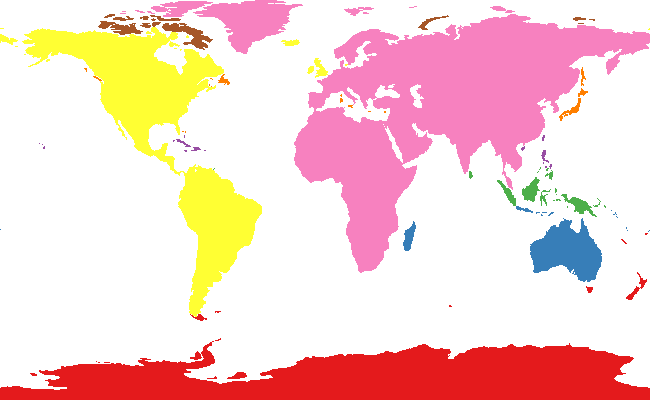

In [68]:
import datashader as ds

def plot_partitions(ddf):
    # Get divisions array
    divs = np.array(ddf.divisions)[:-1]
    
    # Add categorical "partition" column
    ddf2 = ddf.map_partitions(
        lambda df: df.assign(
            partition=pd.Categorical(np.searchsorted(divs, df.index, side="right"))
        )
    ).compute()
    
    # Create Datashader image, coloring countries by partition
    cvs = ds.Canvas(plot_width=650, plot_height=400)
    agg = cvs.polygons(ddf2, geometry='geometry', agg=ds.count_cat('partition'))
    return ds.transfer_functions.shade(agg)

plot_partitions(sidf)

In [18]:
sidf.cx[-80:-85]

#### Spatial Joins

In [19]:
minx, miny, maxx, maxy = sidf.geometry.total_bounds

N = 1_000_000

df_points = gpd.GeoDataFrame(
    {"id": np.arange(N)},
    geometry=gpd.points_from_xy(minx + maxx * np.random.random(N), miny + maxy * np.random.random(N)),
    crs=gdf.crs
)

sdf_points = dd.from_pandas(spd.GeoDataFrame(df_points), npartitions=16).persist()

In [69]:
%%time
spd.sjoin(sdf_points, sdf).compute()

CPU times: user 7.1 s, sys: 4.77 s, total: 11.9 s
Wall time: 1.65 s


,id,geometry,index_right,scalerank,featureclass
2,2,"Point([-166.50080505896946, -88.29312565413248])",7,1,Country
6,6,"Point([-108.05984441918594, -89.07817092631613])",7,1,Country
15,15,"Point([-42.98145403764835, -89.72824475388454])",7,1,Country
16,16,"Point([-102.8149868101838, -87.79487317883103])",7,1,Country
40,40,"Point([-63.73390076435935, -65.48516890146207])",7,1,Country
...,...,...,...,...,...
958352,958352,"Point([-58.4282337549929, -51.71570481905466])",9,1,Country
975437,975437,"Point([-58.20308967641162, -51.56361723528962])",9,1,Country
990247,990247,"Point([-59.41003054865067, -51.91280025072083])",9,1,Country
991651,991651,"Point([-60.90310273654649, -52.01118288691492])",9,1,Country


### dask-geopandas

Parallel GeoPandas with Dask supporting some of the same features as the DaskGeoDataFrame such as spatial indexing and spatial joins.

- [Documentation](https://nbviewer.jupyter.org/github/holoviz/spatialpandas/blob/master/examples/Overview.ipynb)
- [GitHub](https://github.com/geopandas/dask-geopandas/)

Installation:

```
pip install dask-geopandas
```

In [21]:
import dask_geopandas

In [22]:
ddf = dask_geopandas.from_geopandas(df_points, npartitions=4)

In [23]:
%%time
dask_geopandas.sjoin(ddf, gdf).compute()

CPU times: user 8.21 s, sys: 118 ms, total: 8.32 s
Wall time: 2.3 s


,id,geometry,index_right,scalerank,featureclass
2,2,POINT (-166.50081 -88.29313),7,1,Country
6,6,POINT (-108.05984 -89.07817),7,1,Country
15,15,POINT (-42.98145 -89.72824),7,1,Country
16,16,POINT (-102.81499 -87.79487),7,1,Country
40,40,POINT (-63.73390 -65.48517),7,1,Country
...,...,...,...,...,...
951870,951870,POINT (-96.62054 -72.32064),5,1,Country
974257,974257,POINT (-100.73979 -72.10242),5,1,Country
979820,979820,POINT (-99.76412 -72.30717),5,1,Country
982572,982572,POINT (-101.15245 -72.15667),5,1,Country


### cuspatial

- [Documentation](https://intake.readthedocs.io/en/latest/)
- [GitHub](https://github.com/rapidsai/cuspatial)

Installation:

```
conda install -c conda-forge -c rapidsai-nightly cuspatial
```

## Raster data

To represent and work with raster data in Python there are a number of essential tools which in turn build on some or all of the foundational tools above.

<img src="gridded_types.png"></img>

### xarray

Xarray is an open source project and Python package that provides a toolkit for working with labeled multi-dimensional arrays of data. Xarray adopts the Common Data Model for self-describing scientific data in widespread use in the Earth sciences: `xarray.Dataset` is an in-memory representation of a netCDF file. Xarray provides the basic data structures, as well as powerful tools for computation and visualization.

- [Documentation](https://xarray.pydata.org/en/stable/)
- [GitHub](https://github.com/pydata/xarray)

Installation:

```
conda install xarray
```

#### Loading data

In [102]:
import xarray as xr

air_temp = xr.tutorial.open_dataset('air_temperature')

air_temp

<xarray.Dataset>
Dimensions:  (lat: 25, time: 2920, lon: 53)
Coordinates:
  * lat      (lat) float32 75.0 72.5 70.0 67.5 65.0 ... 25.0 22.5 20.0 17.5 15.0
  * lon      (lon) float32 200.0 202.5 205.0 207.5 ... 322.5 325.0 327.5 330.0
  * time     (time) datetime64[ns] 2013-01-01 ... 2014-12-31T18:00:00
Data variables:
    air      (time, lat, lon) float32 ...
Attributes:
    Conventions:  COARDS
    title:        4x daily NMC reanalysis (1948)
    description:  Data is from NMC initialized reanalysis\n(4x/day).  These a...
    platform:     Model
    references:   http://www.esrl.noaa.gov/psd/data/gridded/data.ncep.reanaly...

In [25]:
air_temp.sel({'lat': slice(75, 50), 'lon': slice(200, 220)})

<xarray.Dataset>
Dimensions:  (lat: 11, time: 2920, lon: 9)
Coordinates:
  * lat      (lat) float32 75.0 72.5 70.0 67.5 65.0 ... 60.0 57.5 55.0 52.5 50.0
  * lon      (lon) float32 200.0 202.5 205.0 207.5 210.0 212.5 215.0 217.5 220.0
  * time     (time) datetime64[ns] 2013-01-01 ... 2014-12-31T18:00:00
Data variables:
    air      (time, lat, lon) float32 ...
Attributes:
    Conventions:  COARDS
    title:        4x daily NMC reanalysis (1948)
    description:  Data is from NMC initialized reanalysis\n(4x/day).  These a...
    platform:     Model
    references:   http://www.esrl.noaa.gov/psd/data/gridded/data.ncep.reanaly...

### Datashader

*Accurately render even the largest data*

Datashader is a graphics pipeline system for creating meaningful representations of large datasets quickly and flexibly. Datashader breaks the creation of images into a series of explicit steps that allow computations to be done on intermediate representations. This approach allows accurate and effective visualizations to be produced automatically without trial-and-error parameter tuning, and also makes it simple for data scientists to focus on particular data and relationships of interest in a principled way.

The computation-intensive steps in this process are written in ordinary Python but transparently compiled to machine code using Numba and flexibly distributed across CPU cores and processors using Dask or GPUs using CUDA. This approach provides a highly optimized rendering pipeline that makes it practical to work with extremely large datasets even on standard hardware, while exploiting distributed and GPU systems when available.

- [Documentation](https://datashader.org/)
- [GitHub](https://github.com/holoviz/datashader)

Installation:

```
conda install datashader
```

<style type="text/css">.arbit .trary a { color: inherit; }.arbit .trary
.sL{text-align:center;padding:2px 2px 2px 2px;background-color:#ffffff;font-weight:bold;width:60px}.arbit .trary
.sG{text-align:center;padding:2px 2px 2px 2px;background-color:#ffffff;font-weight:bold;font-family:monospace}.arbit .trary
.sY{text-align:center;padding:2px 2px 2px 2px;background-color:#b7e1cd;}.arbit .trary 
.sN{text-align:center;padding:2px 2px 2px 2px;background-color:#f4c7c3;}.arbit .trary
.sM{text-align:center;padding:2px 2px 2px 2px;background-color:#fce8b2;}.arbit .trary
</style>
<div class="arbit">
<table class="trary" cellspacing="0" cellpadding="0">
<thead>
<tr>
  <th class="sG">Data object</th>
  <th class="sG">Structure</th>
  <th class="sG">Compute</th>
  <th class="sG">Memory</th>
  <th class="sG">Description</th>
  <th class="sG">points</th>
  <th class="sG">line</th>
  <th class="sG">area</th>
  <th class="sG">trimesh</th>
  <th class="sG">raster</th>
  <th class="sG">quadmesh</th>
  <th class="sG">polygons</th>
</tr>
</thead>
<tbody>
<tr>
  <td class="sL"><a href="https://pandas.pydata.org">Pandas DF</a></td>
  <td>columnar</td>
  <td>1-core CPU</td>
  <td>in-core</td>
  <td>Standard dataframes</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
</tr>
<tr>
  <td class="sL"><a href="https://dask.org">DaskDF + PandasDF</a></td>
  <td>columnar</td>
  <td>distributed CPU</td>
  <td>out-of-core</td>
  <td>Distributed DataFrames</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
</tr>
<tr>
  <td class="sL"><a href="https://github.com/rapidsai/cudf">cuDF</a></td>
  <td>columnar</td>
  <td>single GPU</td>
  <td>in-core</td>
  <td>NVIDIA GPU DataFrames</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sN">No</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
</tr>
<tr>
  <td class="sL"><a href="https://docs.rapids.ai/api/cudf/stable/10min.html">DaskDF + cuDF</a></td>
  <td>columnar</td>
  <td>distributed GPU</td>
  <td>out-of-core</td>
  <td>Distributed NVIDIA GPUs</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sN">No</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
</tr>
<tr>
  <td class="sL"><a href="https://github.com/holoviz/spatialpandas">SpatialPandasDF</a></td>
  <td>ragged</td>
  <td>1-core CPU</td>
  <td>in-core</td>
  <td>Ragged + spatial indexing</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sY">Yes</td>
</tr>
<tr>
  <td class="sL"><a href="https://github.com/holoviz/spatialpandas">Dask + SpatialPandasDF</a></td>
  <td>ragged</td>
  <td>distributed CPU</td>
  <td>out-of-core</td>
  <td>Distributed ragged arrays</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sM">-</td>
  <td class="sY">Yes</td>
</tr>
<tr>
  <td class="sL"><a href="http://xarray.pydata.org">Xarray + NumPy</a></td>
  <td>n-D</td>
  <td>1-core CPU</td>
  <td>in-core</td>
  <td>n-D CPU arrays</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sM">-</td>
</tr>
<tr>
  <td class="sL"><a href="(https://dask.org">Xarray+DaskArray</a></td>
  <td>n-D</td>
  <td>distributed CPU</td>
  <td>out-of-core</td>
  <td>Distributed n-D arrays</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sY">Yes</td>
  <td class="sY">Yes</td>
  <td class="sM">-</td>
</tr>
<tr>
  <td class="sL"><a href="https://cupy.chainer.org">Xarray+CuPy</a></td>
  <td>n-D</td>
  <td>single GPU</td>
  <td>in-core</td>
  <td>Single-GPU n-D arrays</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sN">No</td>
  <td class="sY">Yes</td>
  <td class="sM">-</td>
</tr>
</tbody></table></div>


In [71]:
import datashader as ds

W = 1280
H = 768

#### Points

In [27]:
points_df = dd.read_parquet('/Users/philippjfr/development/datashader/examples/data/nyc_taxi.parq/').compute()

points_df

,passenger_count,pickup_x,pickup_y,dropoff_x,dropoff_y
index,,,,,
0,1,-8.236963e+06,4.975553e+06,-8.234835e+06,4.975627e+06
1,1,-8.237826e+06,4.971752e+06,-8.237021e+06,4.976875e+06
2,1,-8.233561e+06,4.983296e+06,-8.232279e+06,4.986477e+06
3,1,-8.238654e+06,4.970221e+06,-8.238124e+06,4.971127e+06
4,1,-8.234434e+06,4.977363e+06,-8.238108e+06,4.974457e+06
...,...,...,...,...,...
11842089,2,-8.232298e+06,4.980860e+06,-8.232492e+06,4.979234e+06
11842090,2,-8.235721e+06,4.972331e+06,-8.234857e+06,4.971131e+06
11842091,1,-8.235341e+06,4.975470e+06,-8.234203e+06,4.981092e+06


In [73]:
%%time
cvs = ds.Canvas(plot_width=W, plot_height=H)

pickup_agg = cvs.points(points_df, 'pickup_x', 'pickup_y')

pickup_agg

CPU times: user 157 ms, sys: 64.7 ms, total: 221 ms
Wall time: 220 ms


<xarray.DataArray (pickup_y: 768, pickup_x: 1280)>
array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint32)
Coordinates:
  * pickup_x  (pickup_x) float64 -8.254e+06 -8.254e+06 ... -8.21e+06 -8.21e+06
  * pickup_y  (pickup_y) float64 4.965e+06 4.965e+06 ... 4.989e+06 4.989e+06

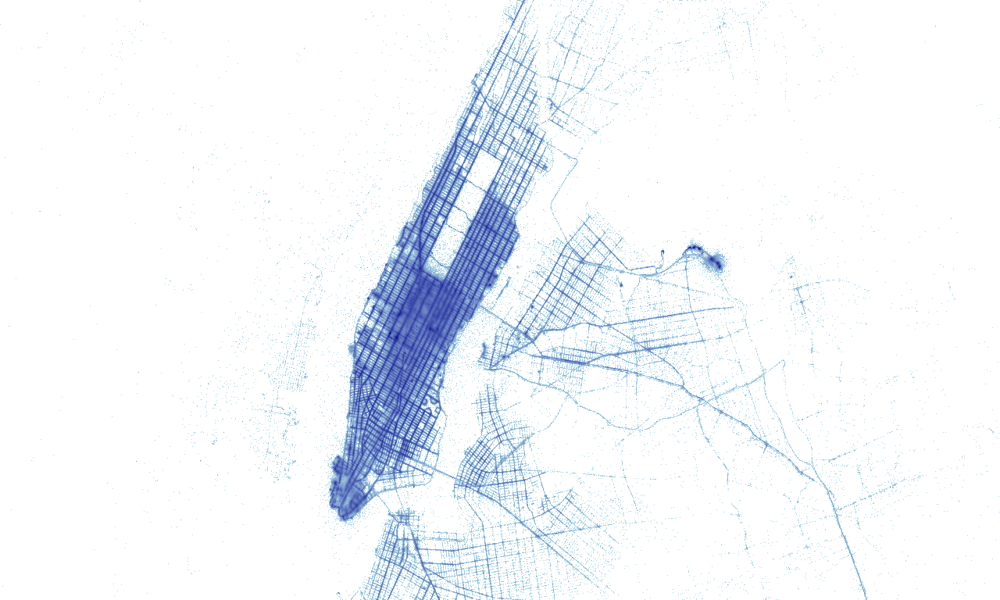

In [29]:
ds.tf.shade(pickup_agg, how='log')

#### Line

In [30]:
streets_df = spd.GeoDataFrame(gpd.read_file('./streets.json'))

streets_df.head()

,CENTLNID,MSTRID,STRNAME,LEFTADD1,LEFTADD2,RGTADD1,RGTADD2,REVDATE,TOFROMIMPE,FROMTOIMPE,...,FENAME,FNAME,FTYPE,FDSUF,PRIVSTRT,ONEWAY,STATUS,STREETTYPE,MBASENMID,geometry
0,4004,1942,PRESCOTT ST,800,998,801,999,2013-10-29,16.946878,16.946878,...,PRESCOTT,PRESCOTT,ST,None,NO,None,BUILT,LOCAL,1611,"MultiLine([[-105.06290653184077, 40.4984269342..."
1,4005,889,FARADAY CIR,1500,1698,1501,1699,2013-10-29,36.913947,36.913947,...,FARADAY,FARADAY,CIR,None,NO,None,BUILT,LOCAL,753,"MultiLine([[-105.0496727444913, 40.53910026546..."
2,4007,1400,LARKBUNTING DR,4546,4598,4545,4599,2013-10-29,6.247920,6.247920,...,LARKBUNTING,LARKBUNTING,DR,None,NO,None,BUILT,LOCAL,1162,"MultiLine([[-105.08283331314883, 40.5242033303..."
3,4008,292,N BRIARWOOD RD,601,605,600,604,2013-10-29,6.937014,6.937014,...,BRIARWOOD,BRIARWOOD,RD,None,NO,None,BUILT,LOCAL,293,"MultiLine([[-105.11806638364482, 40.5943841069..."
4,4011,2036,RICHMOND DR,953,1099,952,1098,2013-10-30,17.037605,17.037605,...,RICHMOND,RICHMOND,DR,None,NO,None,BUILT,COLLECTOR,1694,"MultiLine([[-105.0936808122483, 40.54009427097..."


In [74]:
%%time
cvs = ds.Canvas(plot_width=850, plot_height=500)

street_agg = cvs.line(streets_df, geometry='geometry')

street_agg

CPU times: user 21.5 ms, sys: 23.5 ms, total: 45 ms
Wall time: 84 ms


<xarray.DataArray (y: 500, x: 850)>
array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])
Coordinates:
  * x        (x) float64 -105.2 -105.2 -105.2 -105.2 ... -104.9 -104.9 -104.9
  * y        (y) float64 40.46 40.47 40.47 40.47 ... 40.66 40.66 40.66 40.66

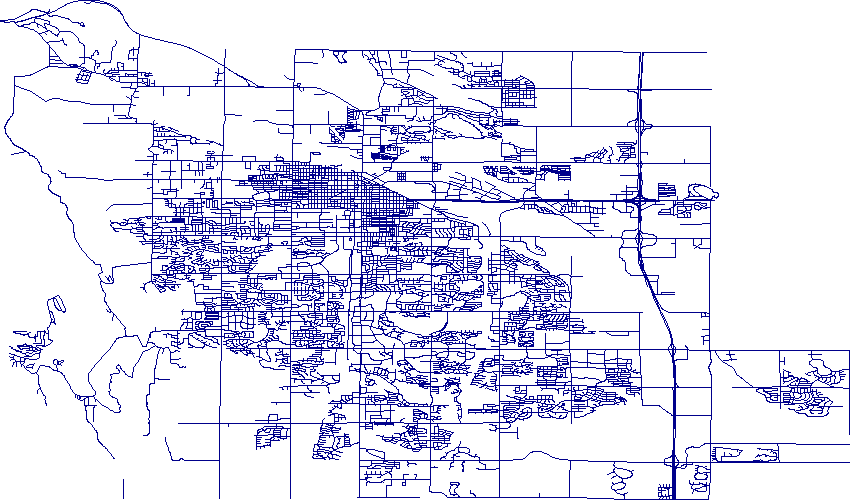

In [75]:
ds.tf.shade(street_agg)

#### Polygons

In [33]:
poly_df = spd.GeoDataFrame(pd.read_parquet('./nyc_buildings.parq/'))

poly_df['type'] = poly_df['type'].astype('category')

In [104]:
len(poly_df)

1157859

In [76]:
%%time
cvs = ds.Canvas(plot_width=W, plot_height=H)

poly_agg = cvs.polygons(poly_df, geometry='geometry', agg=ds.reductions.count_cat('type'))

poly_agg

CPU times: user 1.28 s, sys: 331 ms, total: 1.61 s
Wall time: 1.83 s


<xarray.DataArray (y: 768, x: 1280, type: 164)>
array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
...
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]]], dtype=uint32)
Coordinates:
  * x        (x) float64 -8.278e+06 -8.278e+06 ... -8.201e+06 -8.201e+06
  * y        (y) float64 4.936e+06 4.936e+06 4.936e+06 ... 5.006e+06 5.006e+06
  * type     (type) <U16 '218650358' '4' 'Car Repair Shop' ... 'workshop' 'yes'

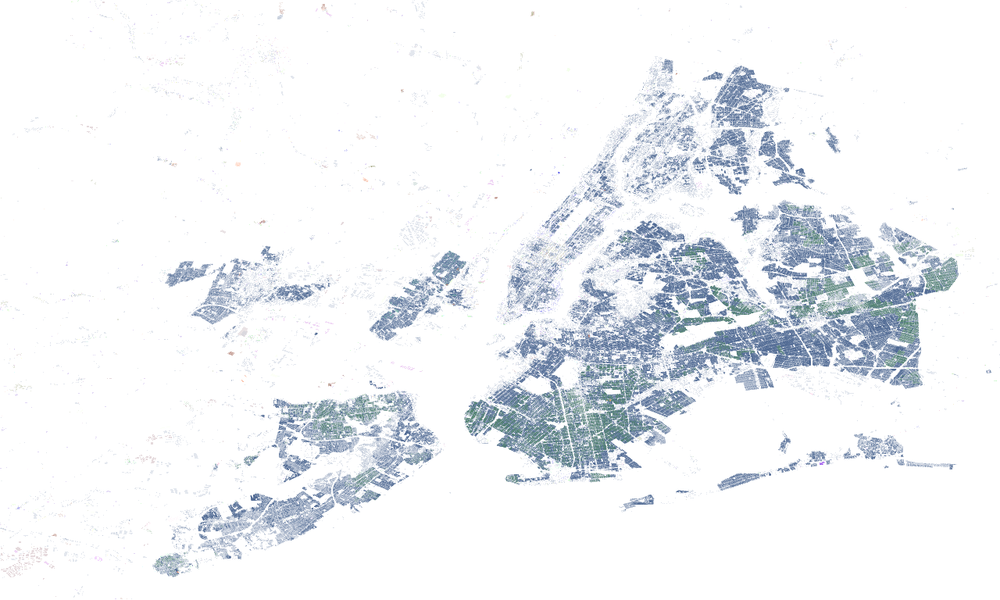

In [35]:
import colorcet

ds.tf.shade(poly_agg, color_key=colorcet.glasbey)

## xarray-spatial

Xarray-Spatial implements common raster analysis functions using Numba and provides an easy-to-install, easy-to-extend codebase for raster analysis.

xarray-spatial does not depend on GDAL / GEOS, which makes it fully extensible in Python but does limit the breadth of operations that can be covered. xarray-spatial is meant to include the core raster-analysis functions needed for GIS developers / analysts, implemented independently of the non-Python geo stack.

- [Documentation](https://xarray-spatial.org/)
- [GitHub](https://github.com/makepath/xarray-spatial)

Installation:

```
conda install -c conda-forge xarray-spatial
```

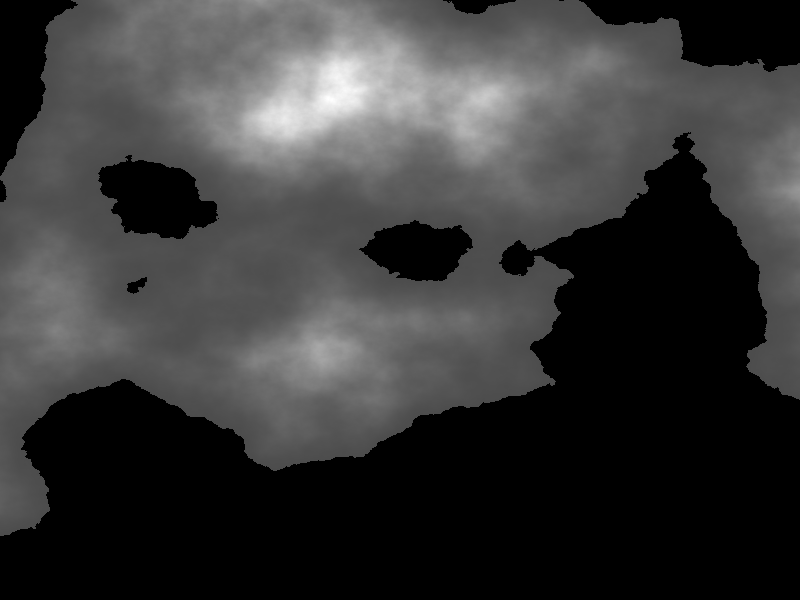

In [36]:
from xrspatial import generate_terrain

W = 800
H = 600

cvs = ds.Canvas(plot_width=W, plot_height=H, x_range=(-20e6, 20e6), y_range=(-20e6, 20e6))

terrain = generate_terrain(canvas=cvs)

ds.tf.shade(terrain, cmap=['black', 'white'], how='linear')

Quantile Warning: Not enough unique valuesfor k classes (using 10 bins)


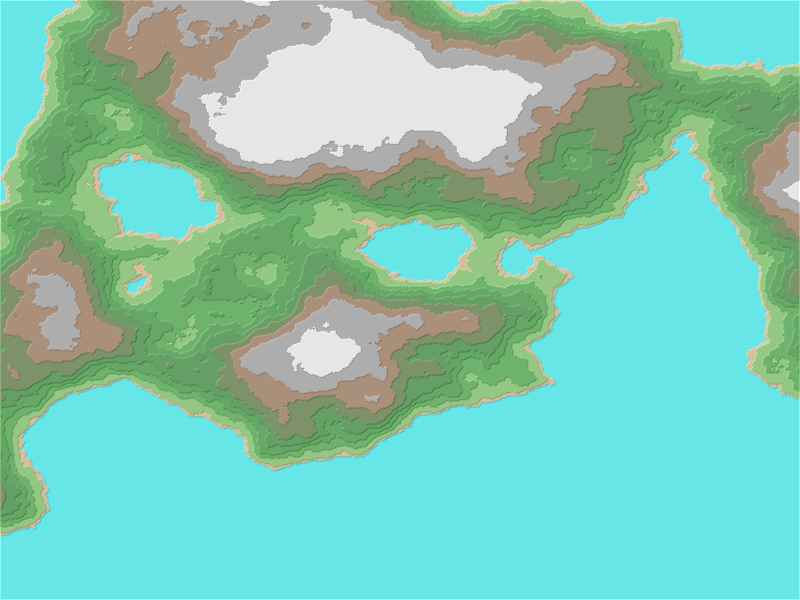

In [37]:
from xrspatial import hillshade
from xrspatial import quantile

qcut_agg = quantile(terrain, k=15)

ds.tf.stack(
    ds.tf.shade(hillshade(qcut_agg), cmap=['gray', 'white'], alpha=255, how='linear'),
    ds.tf.shade(qcut_agg,     cmap=ds.colors.Elevation,      alpha=128, how='linear')
)

In [38]:
most_common = list(poly_df.type.value_counts().sort_values().iloc[-50:].index)

filtered_polys = poly_df[poly_df.type.isin(most_common)].copy()

filtered_polys['zones'] = [most_common.index(t) for t in filtered_polys.type]

cvs = ds.Canvas(
    plot_width=5000, plot_height=5000,
    x_range=(pickup_agg.pickup_x.min().item(), pickup_agg.pickup_x.max().item()),
    y_range=(pickup_agg.pickup_y.min().item(), pickup_agg.pickup_y.max().item())
)

zones_agg = cvs.polygons(filtered_polys, geometry='geometry', agg=ds.reductions.min('zones'))

pickup_agg = cvs.points(points_df, 'pickup_x', 'pickup_y', agg=ds.sum('passenger_count'))
dropoff_agg = cvs.points(points_df, 'dropoff_x', 'dropoff_y', agg=ds.sum('passenger_count'))

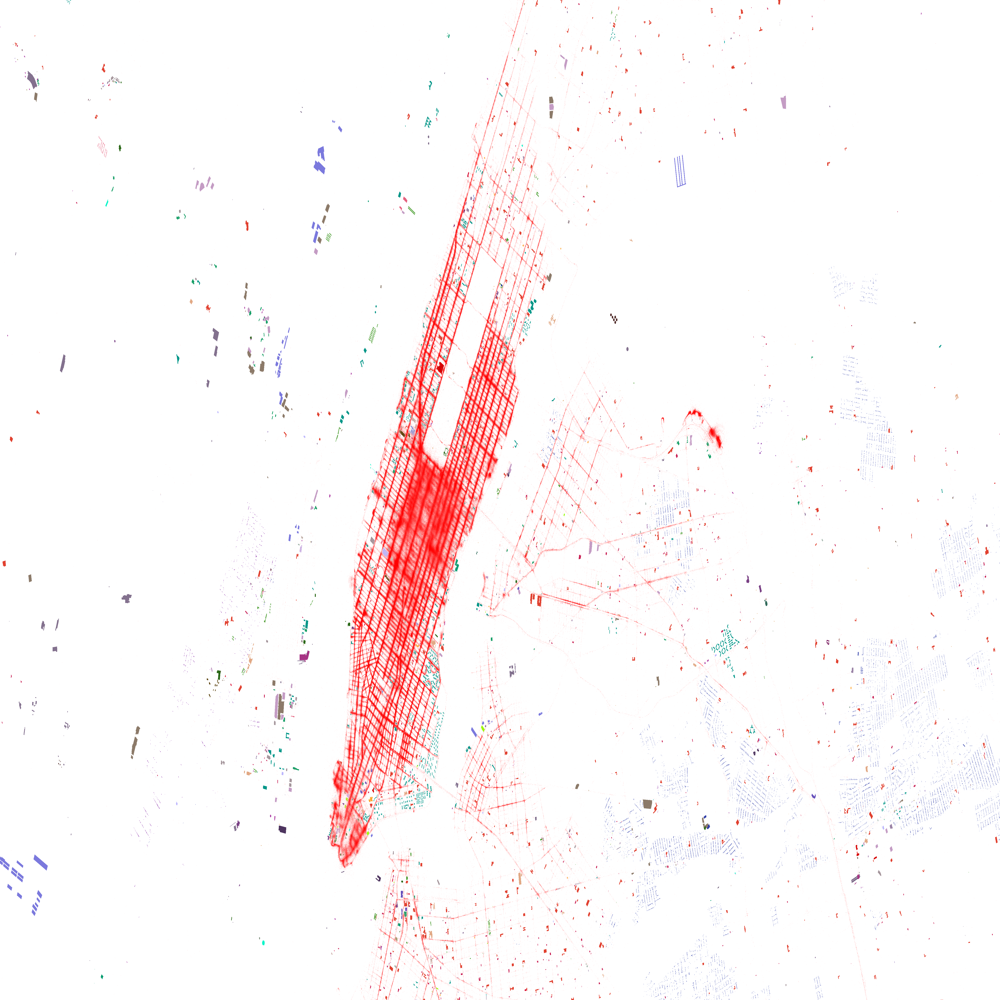

In [40]:
import colorcet as cc

ds.tf.stack(
    ds.tf.shade(zones_agg, cmap=cc.glasbey),
    ds.tf.shade(pickup_agg, cmap=['white', 'red'])
)

In [50]:
from xrspatial import zonal_stats

custom_stats = dict(passenger_pickups=np.sum)

pickup_stats = zonal_stats(zones_agg, pickup_agg, zone_ids=list(range(50)), stats_funcs=custom_stats)
pickup_stats.insert(0, 'Type', [most_common[z] for z in pickup_stats.zone])
pickup_stats.sort_values('passenger_pickups', ascending=False).iloc[:20]

,Type,zone,passenger_pickups
43,commercial,43,352616.0
37,hotel,37,190839.0
46,apartments,46,182327.0
16,attraction,16,49227.0
22,office,22,47408.0
23,theatre,23,32462.0
36,church,36,14697.0
45,place_of_worship,45,10806.0
44,residential,44,8401.0
47,school,47,7459.0


In [91]:
custom_stats = dict(passenger_dropoffs=np.sum)

dropoff_stats = zonal_stats(zones_agg, dropoff_agg, zone_ids=list(range(50)), stats_funcs=custom_stats)
dropoff_stats.insert(0, 'Type', [most_common[z] for z in dropoff_stats.zone])
dropoff_stats.sort_values('passenger_dropoffs', ascending=False).iloc[:20]

,Type,zone,passenger_dropoffs
43,commercial,43,336606.0
37,hotel,37,175734.0
46,apartments,46,171281.0
22,office,22,45014.0
23,theatre,23,32944.0
16,attraction,16,27910.0
36,church,36,18295.0
45,place_of_worship,45,10966.0
47,school,47,10926.0
31,parking,31,9015.0


## Data catalogs

### Intake

Intake is a lightweight set of tools for loading and sharing data in data science projects.

- [Documentation](https://intake.readthedocs.io/en/latest/)
- [GitHub](https://github.com/intake/intake)

Installation:

```
conda install intake
```

Example catalog:

```yaml
plugins:
  source:
    - module: intake_xarray
sources:
  esgf:
    description: CREATE sample
    driver: opendap
    args:
      urlpath: 'http://esgf.nccs.nasa.gov/thredds/dodsC/CREATE-IP/reanalysis/ECMWF/IFS-Cy31r2/day/atmos/pr/pr_day_reanalysis_IFS-Cy31r2_19790101-19791231.nc'
      chunks: {}
      xarray_kwargs:
        decode_times: False
        
  geotiff:
    description: Geotiff image of Landsat Surface Reflectance Level-2 Science Product L5.
    driver: rasterio
    cache:
      - argkey: urlpath
        regex: 'earth-data/landsat'
        type: file
    args:
      urlpath: 's3://earth-data/landsat/small/LT05_L1TP_042033_{collection_date:%Y%m%d}_{processing_date:%Y%m%d}_01_T1_sr_band{band:1d}.tif'
      chunks:
        band: 1
        x: 50
        y: 50
      concat_dim: band
      storage_options: {'anon': True}
    metadata:
      plots:
        band_image:
          kind: 'image'
          x: 'x'
          y: 'y'
          groupby: 'band'
          rasterize: True
```

In [77]:
import intake

cat = intake.open_catalog('/Users/philippjfr/development/hvplot/examples/datasets.yaml')

cat.us_crime.to_dask()

,Year,Population,Violent crime total,Murder and nonnegligent Manslaughter,Legacy rape /1,Revised rape /2,Robbery,Aggravated assault,Property crime total,Burglary,Larceny-theft,Motor vehicle theft,Violent Crime rate,Murder and nonnegligent manslaughter rate,Legacy rape rate /1,Revised rape rate /2,Robbery rate,Aggravated assault rate,Property crime rate,Burglary rate,Larceny-theft rate,Motor vehicle theft rate
npartitions=1,,,,,,,,,,,,,,,,,,,,,,
,int64,int64,int64,int64,int64,float64,int64,int64,int64,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


### STAC


- [Documentation](https://pystac.readthedocs.io/en/1.0/#)
- [GitHub](https://github.com/stac-utils/pystac)

Installation:

```
conda install intake
```

## Visualization

### Matplotlib

Matplotlib is a comprehensive library for creating static, animated, and interactive visualizations in Python.

- [Documentation](https://matplotlib.org/stable/contents.html)
- [GitHub](https://github.com/matplotlib/matplotlib)

Installation:

```
conda install matplotlib
```

#### Geopandas

<AxesSubplot:>

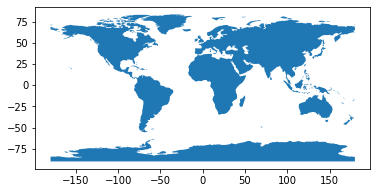

In [79]:
%matplotlib inline

gdf.plot()

#### Xarray

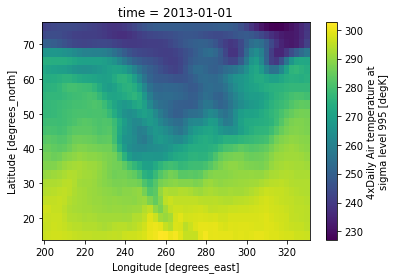

In [80]:
air_temp.air.isel(time=0).plot()

#### Cartopy

Cartopy is a Python package designed for geospatial data processing in order to produce maps and other geospatial data analyses.
    
- [Documentation](https://scitools.org.uk/cartopy/docs/latest/)
- [GitHub](https://github.com/SciTools/cartopy)

Installation:

```
conda install cartopy
```

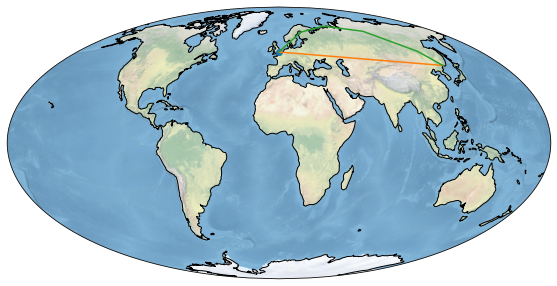

In [82]:
import cartopy.crs as ccrs
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.Mollweide())

# make the map global rather than have it zoom in to
# the extents of any plotted data
ax.set_global()

ax.stock_img()
ax.coastlines()

ax.plot(-0.08, 51.53, 'o', transform=ccrs.PlateCarree())
ax.plot([-0.08, 132], [51.53, 43.17], transform=ccrs.PlateCarree())
ax.plot([-0.08, 132], [51.53, 43.17], transform=ccrs.Geodetic())

### hvPlot

hvPlot provides a high-level plotting API built on HoloViews that provides a general and consistent API for plotting data originating from Pandas, Dask DataFrames, cuDF, xarray, GeoPandas and Spatialpandas. hvPlot can integrate neatly with the individual libraries if an extension mechanism for the native plot APIs is offered, or it can be used as a standalone component.

- [Documentation](https://hvplot.holoviz.org/)
- [GitHub](https://github.com/holoviz/hvplot)

Installation:

```
conda install hvplot
```

In [83]:
import hvplot.xarray
import hvplot.pandas

#### Datashader integration

In [84]:
points_df.hvplot.points('pickup_x', 'pickup_y', rasterize=True, cnorm='log')

:DynamicMap   []
   :Image   [pickup_x,pickup_y]   (pickup_x_pickup_y Count)

In [85]:
import colorcet as cc

poly_df.hvplot.polygons(datashade=True, aggregator=ds.count_cat('type'), color_key=cc.glasbey)

:DynamicMap   []
   :RGB   [x,y]   (R,G,B,A)

#### Geopandas support

In [86]:
gdf.hvplot()

:Polygons   [x,y]

#### xarray support

In [87]:
air_temp.hvplot.image()

:DynamicMap   [time]
   :Image   [lon,lat]   (air)

#### Cartopy projection support via GeoViews

In [88]:
proj = ccrs.Orthographic(-90, 30)

air_temp.air.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True, global_extent=True, 
    cmap='viridis', rasterize=True, coastline=True, frame_width=500)

:DynamicMap   [time]
   :Overlay
      .Image.I     :Image   [lon,lat]   (air)
      .Coastline.I :Feature   [Longitude,Latitude]

### ipyleaflet

Interactive maps in the Jupyter notebook

- [Documentation](https://ipyleaflet.readthedocs.io/en/latest/index.html)
- [GitHub](https://github.com/jupyter-widgets/ipyleaflet)

Installation:

```
conda install -c conda-forge ipyleaflet
```

In [89]:
from ipyleaflet import Map, basemaps, basemap_to_tiles

m = Map(
    basemap=basemap_to_tiles(basemaps.NASAGIBS.ModisTerraTrueColorCR, "2017-04-08"),
    center=(52.204793, 360.121558),
    zoom=4
)

m

Map(center=[52.204793, 360.121558], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title'…

### pydeck

High-scale spatial rendering in Python, powered by deck.gl.

- [Documentation](https://deckgl.readthedocs.io/en/latest/index.html)
- [GitHub](https://github.com/visgl/deck.gl/tree/master/bindings/pydeck)

Installation:

```
conda install -c conda-forge pydeck
```

In [90]:
import pydeck as pdk

DATA_URL = "https://raw.githubusercontent.com/visgl/deck.gl-data/master/examples/geojson/vancouver-blocks.json"
LAND_COVER = [[[-123.0, 49.196], [-123.0, 49.324], [-123.306, 49.324], [-123.306, 49.196]]]

INITIAL_VIEW_STATE = pdk.ViewState(latitude=49.254, longitude=-123.13, zoom=11, max_zoom=16, pitch=45, bearing=0)

polygon = pdk.Layer(
    "PolygonLayer",
    LAND_COVER,
    stroked=False,
    # processes the data as a flat longitude-latitude pair
    get_polygon="-",
    get_fill_color=[0, 0, 0, 20],
)

geojson = pdk.Layer(
    "GeoJsonLayer",
    DATA_URL,
    opacity=0.8,
    stroked=False,
    filled=True,
    extruded=True,
    wireframe=True,
    get_elevation="properties.valuePerSqm / 20",
    get_fill_color="[255, 255, properties.growth * 255]",
    get_line_color=[255, 255, 255],
)

pdk.Deck(layers=[polygon, geojson], initial_view_state=INITIAL_VIEW_STATE)

{"initialViewState": {"bearing": 0, "latitude": 49.254, "longitude": -123.13, "maxZoom": 16, "pitch": 45, "zoom": 11}, "layers": [{"@@type": "PolygonLayer", "data": [[[-123.0, 49.196], [-123.0, 49.324], [-123.306, 49.324], [-123.306, 49.196]]], "getFillColor": [0, 0, 0, 20], "getPolygon": "@@=-", "id": "065283d9-b3fb-4d0e-8933-588c4e5569fa", "stroked": false}, {"@@type": "GeoJsonLayer", "data": "https://raw.githubusercontent.com/visgl/deck.gl-data/master/examples/geojson/vancouver-blocks.json", "extruded": true, "filled": true, "getElevation": "@@=properties.valuePerSqm / 20", "getFillColor": "@@=[255, 255, properties.growth * 255]", "getLineColor": [255, 255, 255], "id": "07f84dee-2a68-492d-9e56-06ab8dfd925d", "opacity": 0.8, "stroked": false, "wireframe": true}], "mapProvider": "carto", "mapStyle": "https://basemaps.cartocdn.com/gl/dark-matter-gl-style/style.json", "views": [{"@@type": "MapView", "controller": true}]}